<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">


# Table of Contents
* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 Training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images



# Install Detectron2 Dependencies

In [1]:
import os

print("Current working directory:", os.getcwd())

Current working directory: /kaggle/working


In [2]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-ddimc0g0
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-ddimc0g0
  Resolved https://github.com/facebookresearch/detectron2.git to commit 80307d2d5e06f06a8a677cc2653f23a4c56402ac
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 8.3 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 49.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4

In [3]:
# import sys
# import os
# import distutils.core

# # Install a specific version of PyYAML
# os.system(f"python -m pip install pyyaml")

# # Clone the Detectron2 repository
# detectron2_repo_url = 'https://github.com/facebookresearch/detectron2'
# os.system(f"git clone '{detectron2_repo_url}'")

# # Run setup and install dependencies from setup.py
# setup_path = "./detectron2/setup.py"
# dist = distutils.core.run_setup(setup_path)
# required_requires = ' '.join([f"'{x}'" for x in dist.install_requires])
# os.system(f"python -m pip install {required_requires}")

# # Add Detectron2 to the Python path
# detectron2_path = os.path.abspath('./detectron2')
# sys.path.insert(0, detectron2_path)

In [3]:
# Importing required libraries
import torch
import detectron2

# Retrieving and displaying Torch and CUDA version information
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print(f"Torch version: {TORCH_VERSION}; CUDA version: {CUDA_VERSION}")

# Displaying Detectron2 version information
print(f"Detectron2 version: {detectron2.__version__}")

Torch version: 2.0; CUDA version: 2.0.0
Detectron2 version: 0.6


In [4]:
# Importing necessary libraries
import detectron2
from detectron2.utils.logger import setup_logger

import matplotlib.pyplot as plt
import numpy as np
import cv2
import random

# Setting up Detectron2 logger
setup_logger()

# Importing common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Import and Register Custom Detectron2 Data

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="3xqoQhgk2T2SnBmvFHiE")
project = rf.workspace("uea-ltv8w").project("medical-waste-bahxi")
dataset = project.version(6).download("coco")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 18.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.3/59.3 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=78f5329d6af2f6115f936a1b81c658070ee92f444ceacf67dea7ce77ef8270d9
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found 

A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Medical-Waste-6 in coco:: 100%|██████████| 595/595 [00:00<00:00, 1766.11it/s]


In [7]:
from detectron2.data.datasets import register_coco_instances

# Register training dataset
train_annotations_path = "/kaggle/working/Medical-Waste-6/train/_annotations.coco.json"
train_image_root = "/kaggle/working/Medical-Waste-6/train"
register_coco_instances("my_dataset_train", {}, train_annotations_path, train_image_root)

# Register validation dataset
val_annotations_path = "/kaggle/working/Medical-Waste-6/valid/_annotations.coco.json"
val_image_root = "/kaggle/working/Medical-Waste-6/valid"
register_coco_instances("my_dataset_val", {}, val_annotations_path, val_image_root)

# Register test dataset
test_annotations_path = "/kaggle/working/Medical-Waste-6/test/_annotations.coco.json"
test_image_root = "/kaggle/working/Medical-Waste-6/test"
register_coco_instances("my_dataset_test", {}, test_annotations_path, test_image_root)


WARNING [08/31 01:18:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/31 01:18:17 d2.data.datasets.coco]: Loaded 512 images in COCO format from /kaggle/working/Medical-Waste-6/train/_annotations.coco.json


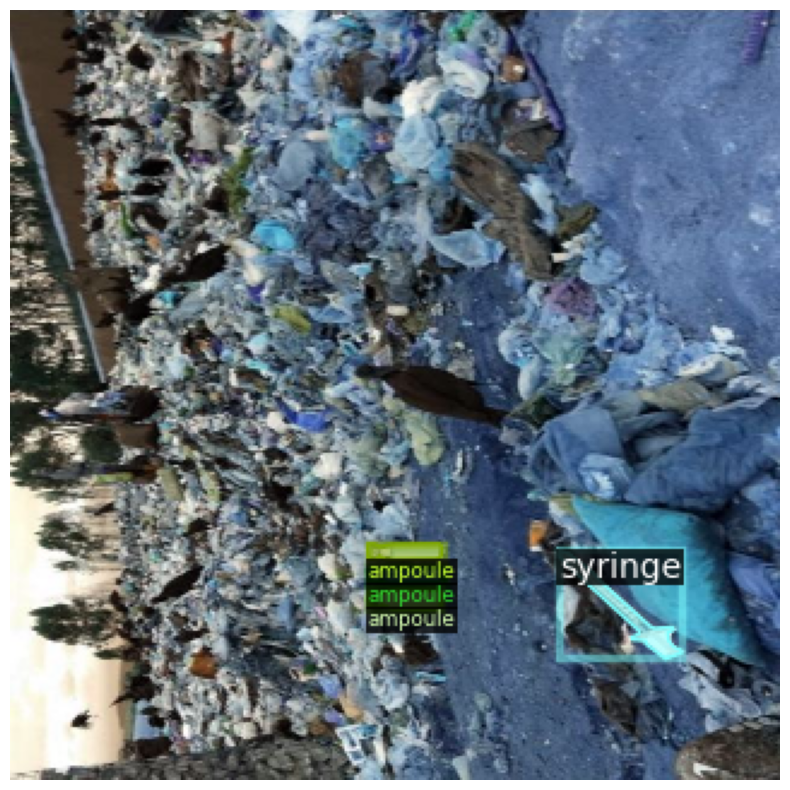

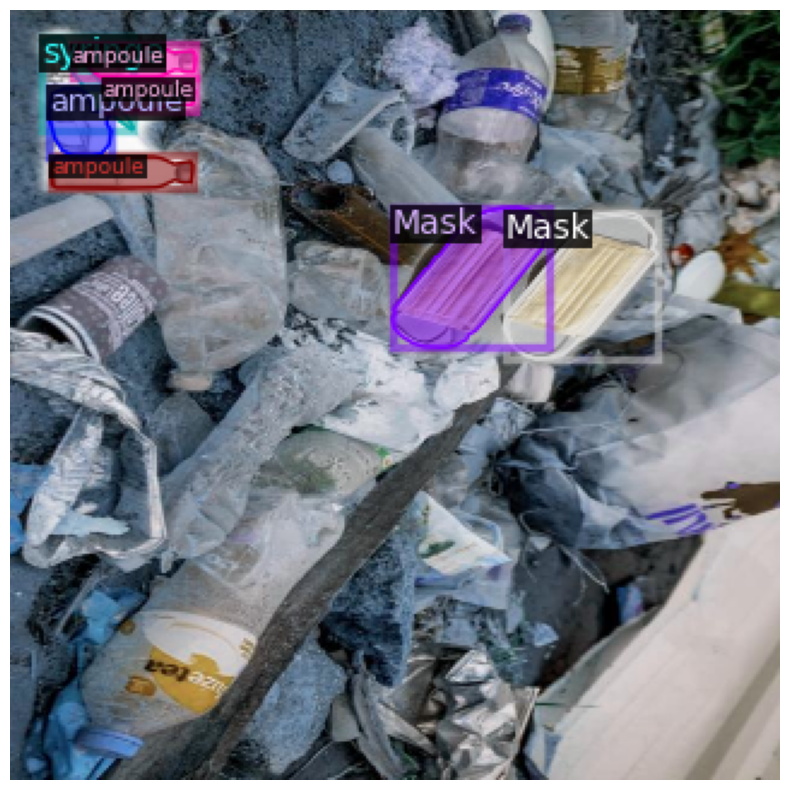

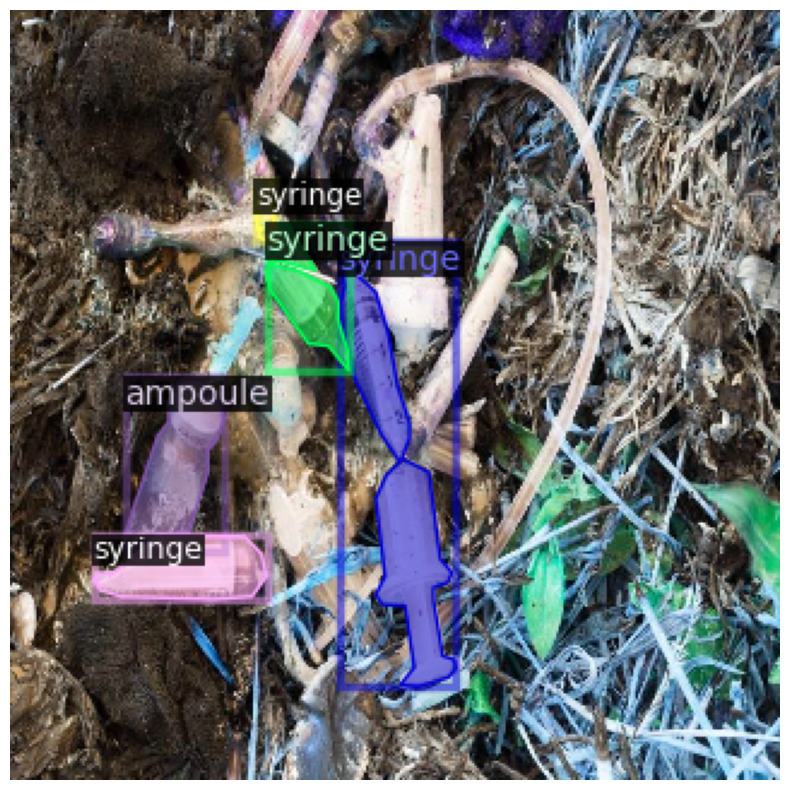

In [8]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    
    plt.figure(figsize=(10, 10))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis('off')  
    plt.show()

 # Train Custom Detectron2 Detector

In [9]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        """
        Build and return a COCOEvaluator for validation during training.

        Args:
            cfg (CfgNode): Configuration node for Detectron2.
            dataset_name (str): Name of the dataset.
            output_folder (str): Path to the output folder for evaluation results.

        Returns:
            COCOEvaluator: A COCOEvaluator instance for validation evaluation.
        """
        if output_folder is None:
            os.makedirs("coco_eval", exist_ok=True)
            output_folder = "coco_eval"

        return COCOEvaluator(dataset_name, cfg, False, output_folder)


In [10]:
# Create the configuration object
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")

# Set training parameters
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3000
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

# Set model parameters
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6  # Your number of classes + 1

# Set evaluation parameters
cfg.TEST.EVAL_PERIOD = 500

# Create output directory if it doesn't exist
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Initialize and train the model
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[08/31 01:18:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:02, 201MB/s]                             


[08/31 01:19:01 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/TensorShape.cpp:3483.)


[08/31 01:19:45 d2.utils.events]:  eta: 1:33:09  iter: 19  total_loss: 2.91  loss_cls: 1.919  loss_box_reg: 0.5071  loss_rpn_cls: 0.4296  loss_rpn_loc: 0.05836    time: 1.7750  last_time: 1.8951  data_time: 0.0419  last_data_time: 0.0324   lr: 1.931e-06  max_mem: 6874M


unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tensorflow13GcsFileSystemE']


[08/31 01:20:28 d2.utils.events]:  eta: 1:26:29  iter: 39  total_loss: 2.785  loss_cls: 1.896  loss_box_reg: 0.6306  loss_rpn_cls: 0.2395  loss_rpn_loc: 0.03535    time: 1.8145  last_time: 1.9100  data_time: 0.0314  last_data_time: 0.0424   lr: 2.911e-06  max_mem: 6874M
[08/31 01:21:04 d2.utils.events]:  eta: 1:25:22  iter: 59  total_loss: 2.69  loss_cls: 1.832  loss_box_reg: 0.5936  loss_rpn_cls: 0.2491  loss_rpn_loc: 0.05404    time: 1.8073  last_time: 1.8952  data_time: 0.0339  last_data_time: 0.0308   lr: 3.891e-06  max_mem: 6874M
[08/31 01:21:41 d2.utils.events]:  eta: 1:28:47  iter: 79  total_loss: 2.519  loss_cls: 1.749  loss_box_reg: 0.4696  loss_rpn_cls: 0.2138  loss_rpn_loc: 0.03295    time: 1.8098  last_time: 1.8970  data_time: 0.0319  last_data_time: 0.0324   lr: 4.871e-06  max_mem: 6874M
[08/31 01:22:17 d2.utils.events]:  eta: 1:30:42  iter: 99  total_loss: 2.551  loss_cls: 1.686  loss_box_reg: 0.5174  loss_rpn_cls: 0.3077  loss_rpn_loc: 0.03603    time: 1.8144  last_time:

In [12]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[08/31 02:51:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [08/31 02:51:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/31 02:51:26 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/31 02:51:26 d2.data.datasets.coco]: Loaded 25 images in COCO format from /kaggle/working/Medical-Waste-6/test/_annotations.coco.json
[08/31 02:51:26 d2.data.build]: Distribution of instances among all 5 categories:
|   category    | #instances   |  category  | #instances   |  category  | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| medical-waste | 0            | Blood bag  | 17           |    Mask    | 20           |
|    ampoule    | 43           |  syringe   | 60           |            |              

OrderedDict([('bbox',
              {'AP': 22.39854953965874,
               'AP50': 45.69605864817225,
               'AP75': 18.668680304594766,
               'APs': 26.871633413341208,
               'APm': 25.44376759563944,
               'APl': 23.98021119493502,
               'AP-medical-waste': nan,
               'AP-Blood bag': 20.620643042565124,
               'AP-Mask': 31.813022927248436,
               'AP-ampoule': 17.563558137060596,
               'AP-syringe': 19.59697405176082})])

# Inference with Detectron2 Saved Weights



In [13]:
directory_path = "./output/"
os.listdir(directory_path)

['last_checkpoint',
 'coco_instances_results.json',
 'model_final.pth',
 'events.out.tfevents.1693444791.a3f58f5e6f2a.28.0',
 'instances_predictions.pth',
 'metrics.json']

In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[08/31 02:51:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


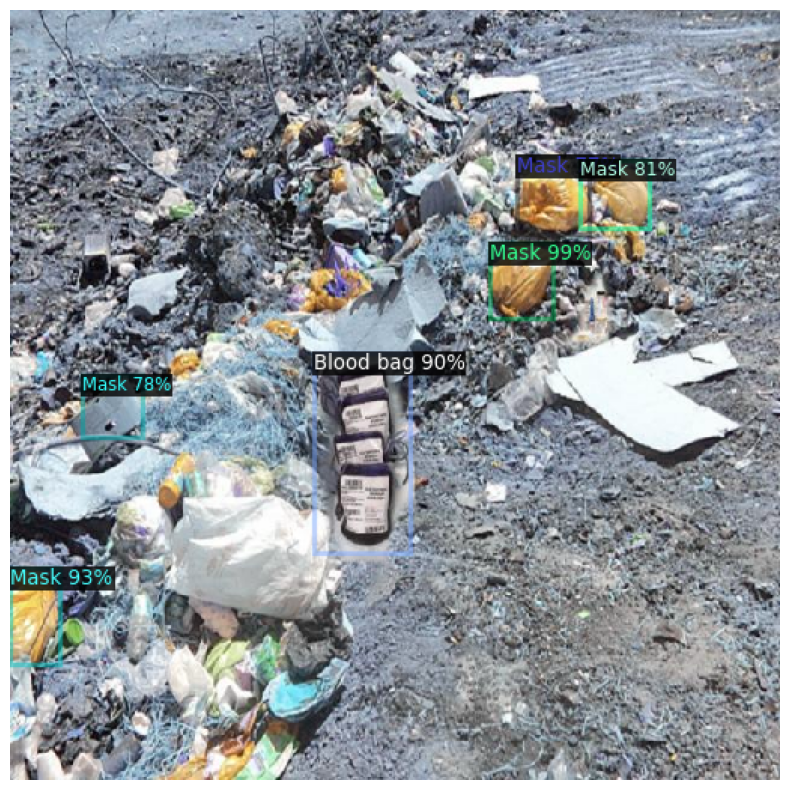

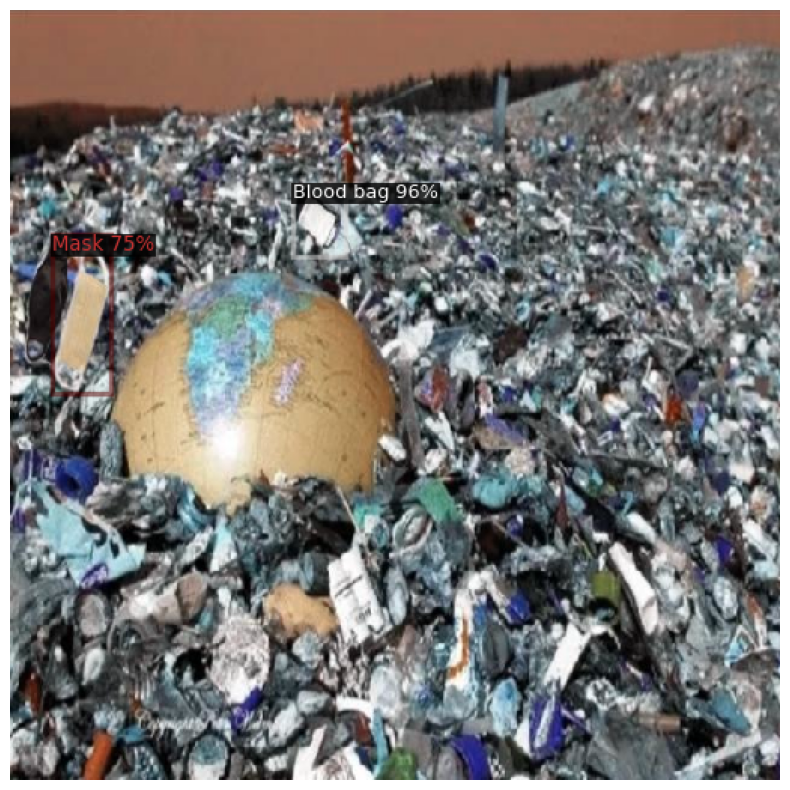

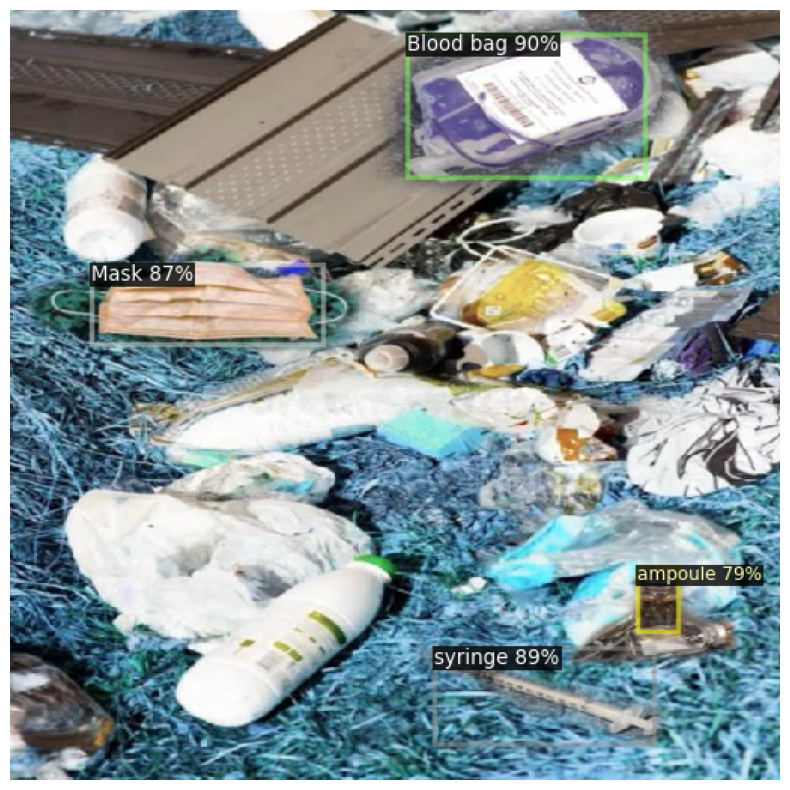

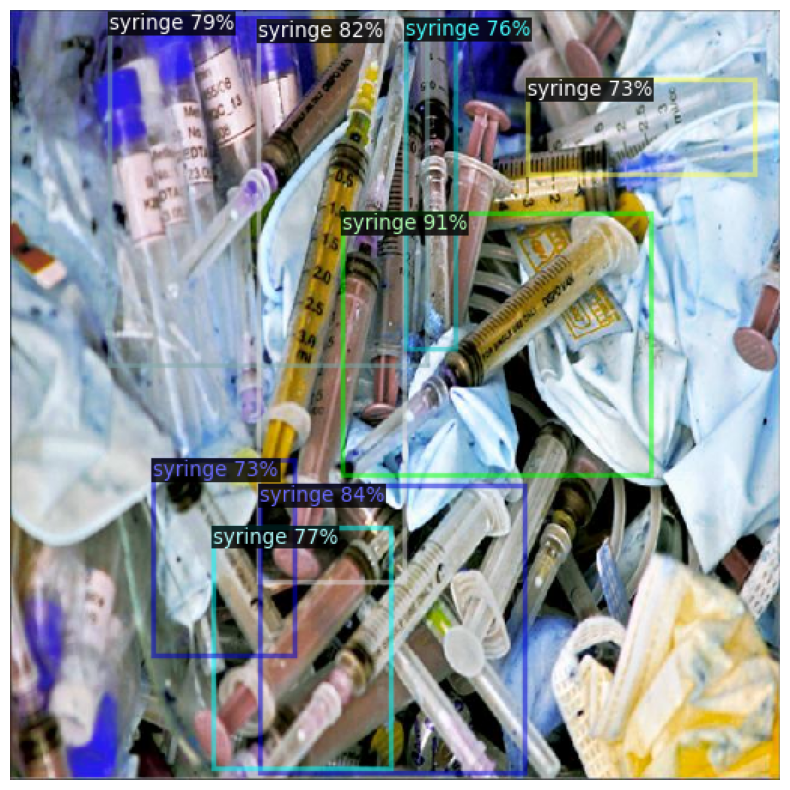

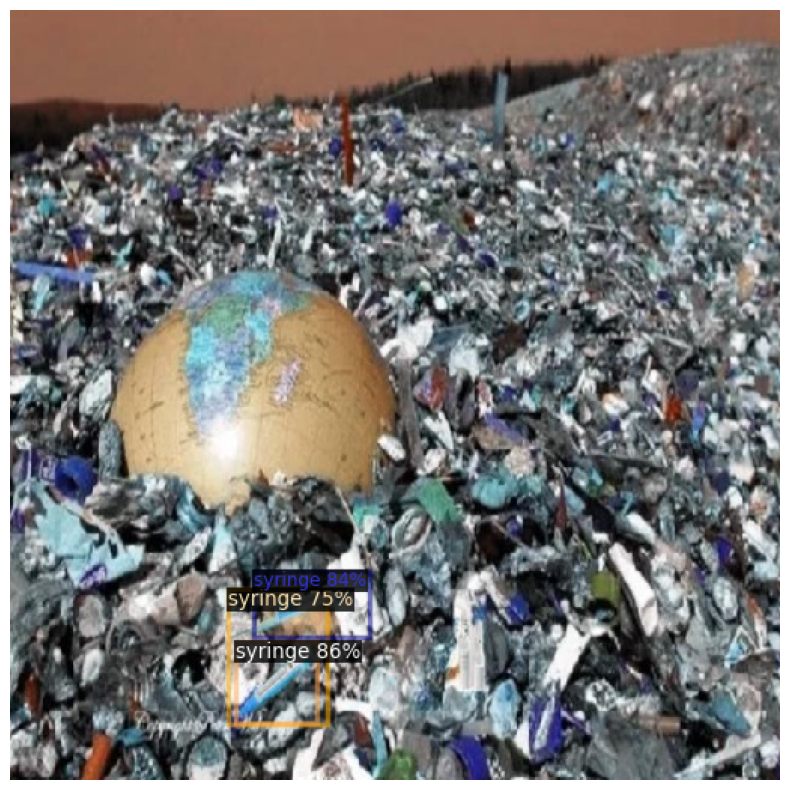

...

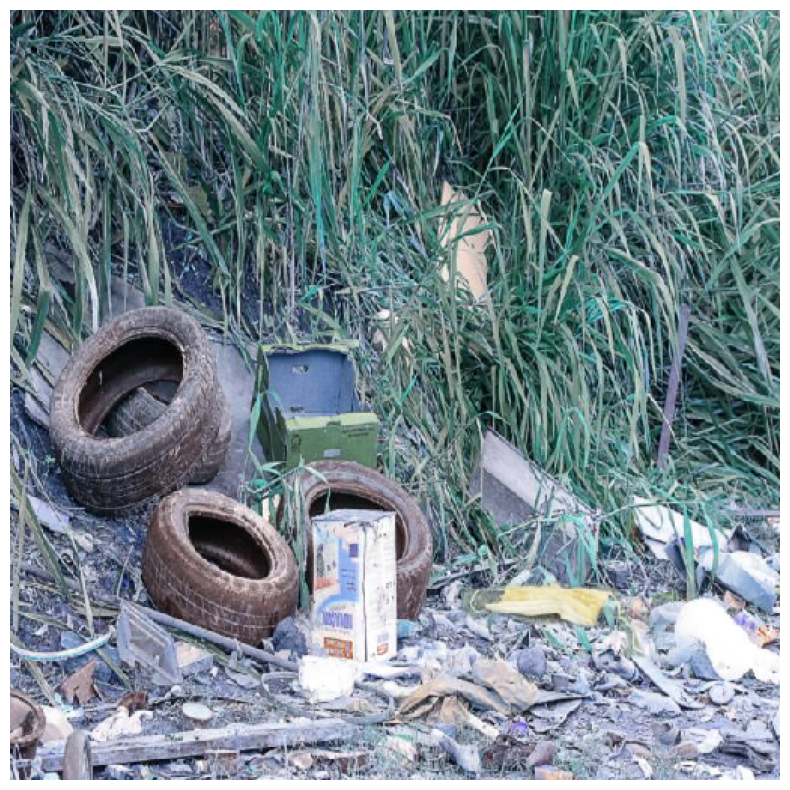

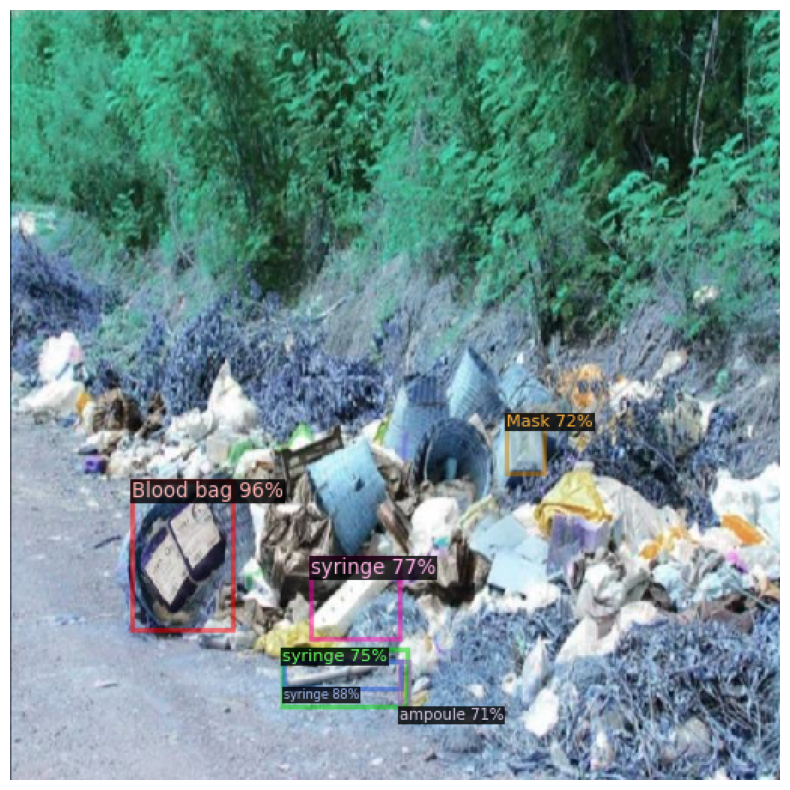

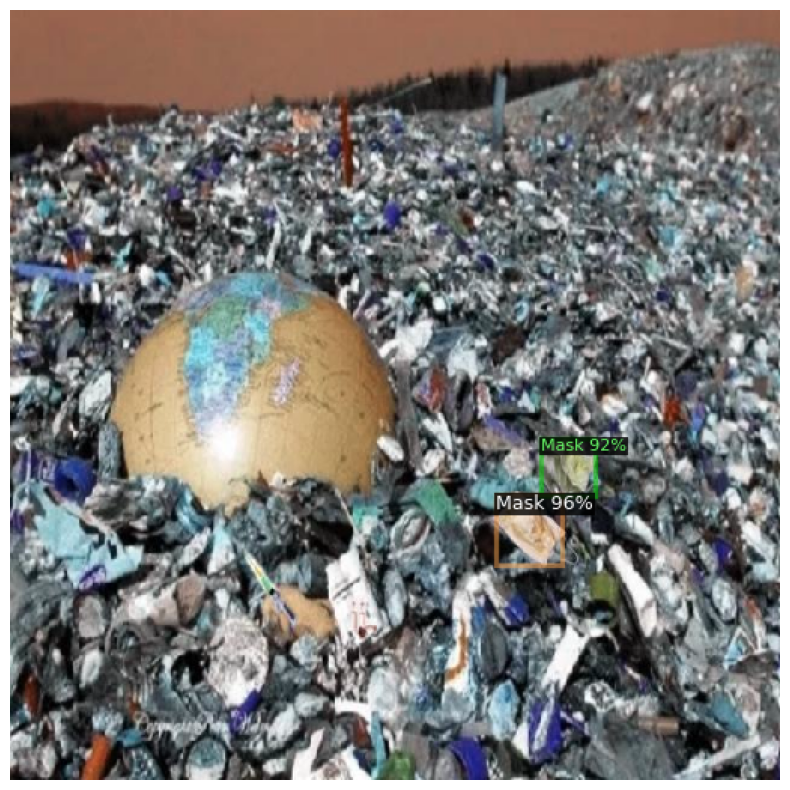

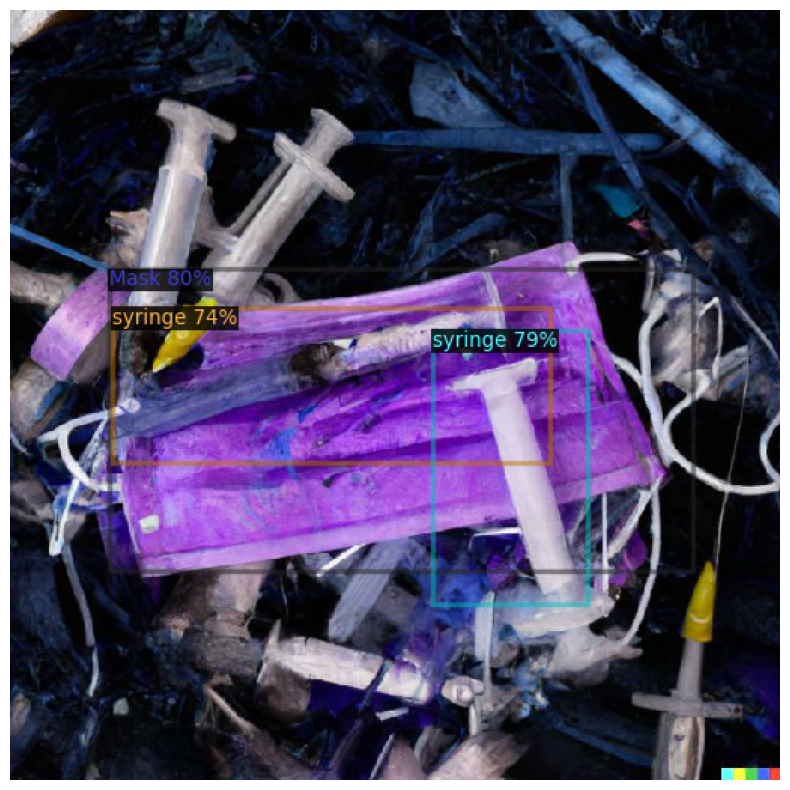

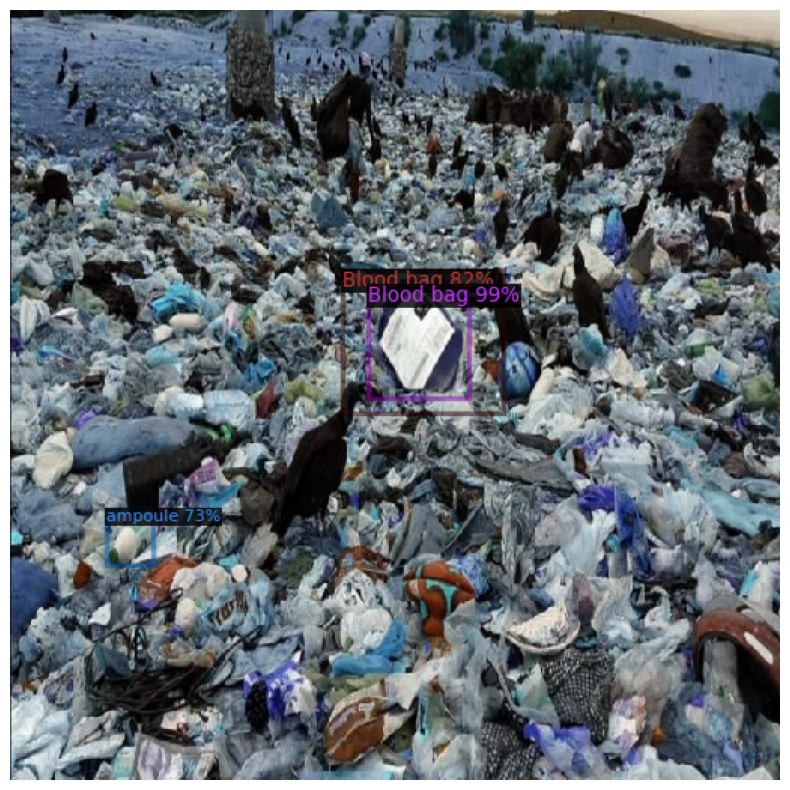

In [18]:
from detectron2.utils.visualizer import ColorMode
import glob
import matplotlib.pyplot as plt

for imageName in glob.glob('/kaggle/working/Medical-Waste-6/test/*jpg'):
    im = cv2.imread(imageName)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                    metadata=test_metadata, 
                    scale=0.8
                     )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Display the image using Matplotlib
    plt.figure(figsize=(10, 10))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')  # Turn off axis labels and ticks
    plt.show()  # Show the image using Matplotlib
